# 2020 - 02 - 08 | Exam

## Ex. 4 — Choropleth map and statistical chart

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

census = pd.read_excel(r'census.xlsx')

print(census)

   ANNI  Piemonte  Valle d'Aosta-Vallée d'Aoste   Liguria  Lombardia  \
0  1951  3518.000                        94.000  1567.000   6566.000   
1  1961  3914.250                       100.959  1735.349   7406.152   
2  1971  4432.000                       109.000  1854.000   8543.000   
3  1981  4479.000                       112.000  1808.000   8892.000   
4  1991  4303.000                       116.000  1676.000   8856.000   
5  2001  4214.677                       119.548  1571.783   9032.554   
6  2011  4363.916                       126.806  1570.694   9704.151   

   Trentino-Alto Adige/Südtirol  Bolzano-Bozen   Trento    Veneto  \
0                       729.000        334.000  395.000  3918.000   
1                       785.967        373.863  412.104  3846.562   
2                       842.000        414.000  428.000  4123.000   
3                       873.000        431.000  443.000  4345.000   
4                       890.000        441.000  450.000  4381.000   
5        

In [19]:
census = census[(census['ANNI'] == 2011) | (census['ANNI'] == 2001)]

census

,ANNI,Piemonte,Valle d'Aosta-Vallée d'Aoste,Liguria,Lombardia,Trentino-Alto Adige/Südtirol,Bolzano-Bozen,Trento,Veneto,Friuli-Venezia Giulia,...,Marche,Lazio,Abruzzo,Molise,Campania,Puglia,Basilicata,Calabria,Sicilia,Sardegna
5,2001,4214.677,119.548,1571.783,9032.554,940.016,462.999,477.017,4527.694,1183.764,...,1470.581,5112.413,1262.392,320.601,5701.931,4020.707,597.768,2011.466,4968.991,1631.880
6,2011,4363.916,126.806,1570.694,9704.151,1029.475,505.000,525.000,4857.210,1218.985,...,1541.319,5502.886,1307.309,313.660,5766.810,4052.566,578.036,1959.050,5002.904,1639.362


We need a tall dataset for these charts. Let's do it!

In [20]:
regions = census.columns.tolist()
regions = regions[1:]

census = pd.melt(census, id_vars="ANNI", value_vars=regions, var_name="Regions", value_name="Census")

We should achieve what we want. Let's have a look.

In [21]:
census

,ANNI,Regions,Census
0,2001,Piemonte,4214.677
1,2011,Piemonte,4363.916
2,2001,Valle d'Aosta-Vallée d'Aoste,119.548
3,2011,Valle d'Aosta-Vallée d'Aoste,126.806
4,2001,Liguria,1571.783
5,2011,Liguria,1570.694
6,2001,Lombardia,9032.554
7,2011,Lombardia,9704.151
8,2001,Trentino-Alto Adige/Südtirol,940.016
9,2011,Trentino-Alto Adige/Südtirol,1029.475


Now we are ready to plot the barchart, but first we need to prepare the data for the choropleth map.

In [29]:
from urllib.request import urlopen # import request for fetching url
import json

with urlopen('https://raw.githubusercontent.com/openpolis/geojson-italy/master/geojson/limits_IT_regions.geojson') as response:
    it_regions = json.load(response)

var = it_regions["features"][0]

census_2011 = census[census['ANNI'] == 2011]

census_2011

,ANNI,Regions,Census
1,2011,Piemonte,4363.916
3,2011,Valle d'Aosta-Vallée d'Aoste,126.806
5,2011,Liguria,1570.694
7,2011,Lombardia,9704.151
9,2011,Trentino-Alto Adige/Südtirol,1029.475
11,2011,Bolzano-Bozen,505.000
13,2011,Trento,525.000
15,2011,Veneto,4857.210
17,2011,Friuli-Venezia Giulia,1218.985
19,2011,Emilia-Romagna,4342.135


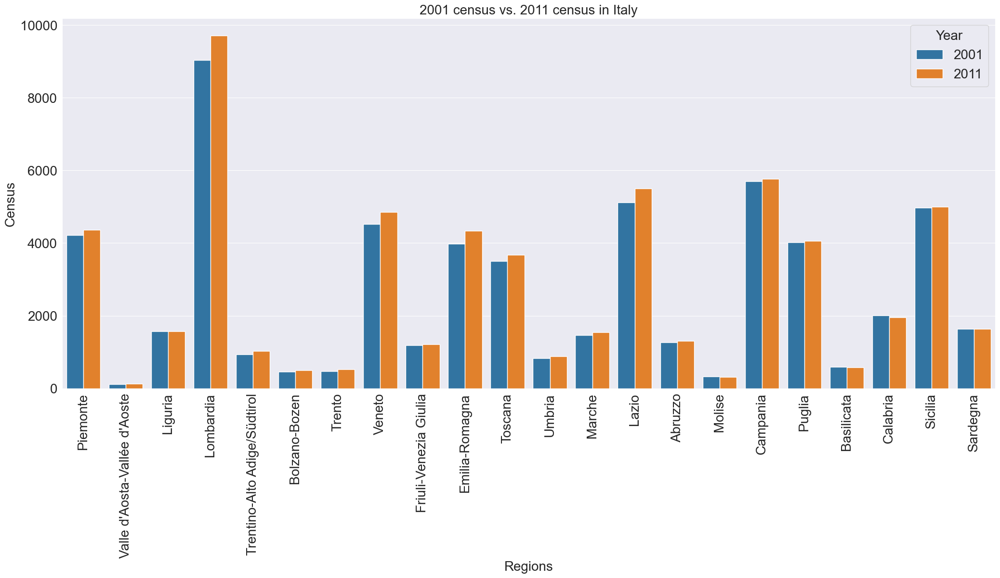

In [35]:
import plotly.express as px

fig, axes = plt.subplots(figsize=(25, 10), ncols=1, nrows=1)

# choropleth
fig = px.choropleth(
    census_2011, # dataframe
    geojson=it_regions, # geojson
    locations="Regions",
    featureidkey='properties.reg_name', # feature of our interest in geojson
    color='Census',
    color_continuous_scale='Viridis',
    range_color=(min(census['Census'].tolist()), max(census['Census'].tolist())),
    labels={"Regions":"Regions", "Census":"Census"},
    title="Census by region in Italy in 2011",
    hover_data=["Regions", "Census"],
    center={'lon': 14, 'lat': 40},
    #mapbox_style='open-street-map',
    #zoom=3
)
fig.update_geos(showcountries=False, showcoastlines=False, showland=False, fitbounds="locations")
fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0})
fig.show()

# bar plot
sns.barplot(census, x="Regions", y="Census", hue="ANNI")
plt.title("2001 census vs. 2011 census in Italy", fontsize = 20)
plt.xticks(rotation = 90, fontsize = 20)
plt.yticks(fontsize = 20)
plt.xlabel("Regions", fontsize = 20)
plt.ylabel("Census", fontsize = 20)
plt.legend(title = "Year", fontsize = 20, title_fontsize = 20)
plt.show()



# Ex. 5 - UMAP

In [37]:
import pandas as pd

microbiome = pd.read_csv("microbiome.csv")

microbiome.head()

,OTU0,OTU1,OTU2,OTU3,OTU4,OTU5,OTU6,OTU7,OTU8,OTU9,...,OTU6686,OTU6687,OTU6688,OTU6689,OTU6690,OTU6691,OTU6692,OTU6693,OTU6694,OTU6695
0,1.558520e-11,4.724120e-11,1.225880e-11,4.515660e-11,2.718290e-11,2.706710e-11,3.306490e-11,5.078730e-11,1.845710e-11,0.002566,...,6.661360e-11,3.021640e-11,4.415210e-11,7.311330e-11,7.772160e-11,4.333640e-11,5.437370e-11,8.723940e-11,2.713500e-11,4.966000e-11
1,2.359220e-11,9.533200e-11,3.330680e-11,2.669130e-11,2.019270e-11,2.505580e-11,6.753770e-11,9.076440e-11,8.707380e-11,0.000252,...,3.255580e-12,5.385290e-11,4.725960e-11,2.600370e-11,4.242660e-11,6.546480e-11,4.848670e-11,8.377660e-11,3.498560e-11,7.617720e-11
2,6.771010e-11,3.682960e-11,8.018540e-11,5.488950e-11,1.341180e-11,5.115210e-11,5.806820e-11,6.466670e-11,1.447080e-11,0.002336,...,7.231020e-11,6.298250e-12,7.062920e-11,8.313000e-11,3.307660e-11,7.383310e-11,4.448790e-11,9.645520e-12,7.880280e-11,3.992640e-11
3,5.520270e-11,9.890760e-11,4.581380e-11,3.539770e-11,2.092110e-11,6.255510e-11,9.341670e-11,5.372400e-11,6.280840e-11,0.000741,...,9.095820e-11,2.935560e-11,9.996590e-11,9.821790e-11,8.541320e-11,9.727770e-11,2.959570e-11,8.581660e-13,5.876120e-11,5.506230e-11
4,5.238120e-11,6.340330e-11,2.354280e-11,7.469650e-11,2.489830e-11,4.048870e-13,3.337430e-11,8.499950e-12,4.558400e-11,0.000493,...,1.504300e-11,4.900990e-11,8.106680e-12,4.669770e-11,8.265580e-11,4.631170e-11,1.600100e-11,5.546980e-11,7.840300e-11,8.564610e-11


Now let's import UMAP and the packages we need.

In [ ]:
import umap.umap_ as umap
import numpy as np
import matplotlib.pyplot as plt

# TO CONTINUE!

# Ex. 6 - Chord diagram

In [20]:
import pandas as pd

migration = pd.read_excel(r'migration.xlsx')

print(migration)

   Unnamed: 0          Unnamed: 1    DESTINATION       Unnamed: 3  \
0         NaN                 NaN  North America  Central America   
1      ORIGIN       North America          96102           208668   
2         NaN     Central America        3233173           215008   
3         NaN       South America         394674            26456   
4         NaN        North Africa          62193               93   
5         NaN  Sub-Saharan Africa         478694              793   
6         NaN     Northern Europe          47627             2770   
7         NaN      Western Europe           9854             1040   
8         NaN     Southern Europe            713              449   
9         NaN      Eastern Europe           7455               36   
10        NaN        Central Asia          15473               37   
11        NaN        Western Asia         170652              645   
12        NaN          South Asia        1508008             3846   
13        NaN           East Asia 

In [24]:
# rename columns
continents = []
for continent in migration.loc[0]:
    continents.append(continent)

continents[0] = "toDrop"
continents[1] = "origin"
print(continents)

i = 0
for column in migration.columns:
    migration = migration.rename(columns={column: continents[i]})
    i += 1

migration = migration.drop(['toDrop'], axis = 1)
migration = migration.drop(0)

['toDrop', 'origin', 'North America', 'Central America', 'South America', 'North Africa', 'Sub-Saharan Africa', 'Northern Europe', 'Western Europe', 'Southern Europe', 'Eastern Europe', 'Central Asia', 'Western Asia', 'South Asia', 'East Asia', 'South-East Asia', 'Oceania']


In [25]:
print(migration)

                origin North America Central America South America  \
1        North America         96102          208668         68240   
2      Central America       3233173          215008         36975   
3        South America        394674           26456        600759   
4         North Africa         62193              93           692   
5   Sub-Saharan Africa        478694             793         10738   
6      Northern Europe         47627            2770          6125   
7       Western Europe          9854            1040          5396   
8      Southern Europe           713             449           236   
9       Eastern Europe          7455              36           706   
10        Central Asia         15473              37           258   
11        Western Asia        170652             645          8886   
12          South Asia       1508008            3846          2888   
13           East Asia       1057904            9189         25953   
14     South-East As

In [30]:
arr_migration = pd.melt(migration, id_vars="origin", value_vars=['North America', 'Central America', 'South America', 'North Africa', 'Sub-Saharan Africa', 'Northern Europe', 'Western Europe', 'Southern Europe', 'Eastern Europe', 'Central Asia', 'Western Asia', 'South Asia'], var_name = "destination")

arr_migration['value'] = pd.to_numeric(arr_migration['value'])

print(arr_migration)

                 origin    destination    value
0         North America  North America    96102
1       Central America  North America  3233173
2         South America  North America   394674
3          North Africa  North America    62193
4    Sub-Saharan Africa  North America   478694
..                  ...            ...      ...
175        Western Asia     South Asia    16120
176          South Asia     South Asia  1307907
177           East Asia     South Asia      117
178     South-East Asia     South Asia    59126
179             Oceania     South Asia        5

[180 rows x 3 columns]


In [31]:
arr_migration = arr_migration[arr_migration['value'] > 170000]

print(arr_migration)

                 origin         destination    value
1       Central America       North America  3233173
2         South America       North America   394674
4    Sub-Saharan Africa       North America   478694
10         Western Asia       North America   170652
11           South Asia       North America  1508008
12            East Asia       North America  1057904
13      South-East Asia       North America   973060
15        North America     Central America   208668
16      Central America     Central America   215008
32        South America       South America   600759
64   Sub-Saharan Africa  Sub-Saharan Africa  3717881
75        North America     Northern Europe   248379
79   Sub-Saharan Africa     Northern Europe   483736
80      Northern Europe     Northern Europe   172448
86           South Asia     Northern Europe   755399
87            East Asia     Northern Europe   200949
88      South-East Asia     Northern Europe   176095
90        North America      Western Europe   

## It's time to print the chord diagram!

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
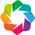

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

In [46]:
import holoviews as hv

hv.extension('bokeh')
hv.extension('matplotlib')


In [33]:
chord = hv.Chord(arr_migration)
chord

:Chord   [origin,destination]   (value)

We can do better.. let's select unique origins and destinations.

In [44]:
continents = list(
    set(
        arr_migration['origin'].unique().tolist() + arr_migration['destination'].unique().tolist()
    )
)

print(continents)

continents_df = hv.Dataset(pd.DataFrame(continents, columns=['continents']))

['South Asia', 'Central America', 'South-East Asia', 'South America', 'North America', 'Sub-Saharan Africa', 'Northern Europe', 'Western Europe', 'Southern Europe', 'East Asia', 'Eastern Europe', 'Central Asia', 'North Africa', 'Western Asia']
:Dataset   [continents]


:Chord   [origin,destination]   (value)
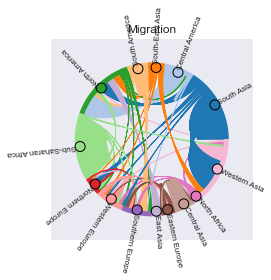

In [57]:
%%opts Chord [height=1000, width=1000 title="Migration" labels="continents"]
%%opts Chord (node_color="continents", node_cmap="Category20" edge_color=dim("origin") edge_cmap="Category20")
chord = hv.Chord((arr_migration, continents_df))
chord